#### The all important imports

In [101]:
import uproot
import awkward as ak
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import mplhep as hep
import hist

#### Here we make a list of all the file paths we may be working with.

In [80]:
fileset = {}

sig_dir = '/ceph/cms/store/user/aaportel/B-Parking/rechits_v2/BToKPhi_MuonLLPDecayGenFilter_PhiToPi0Pi0_mPhi0p3_ctau300/'
fileset['sample'] = [sig_dir + f'BToKPhi_MuonLLPDecayGenFilter_PhiToPi0Pi0_mPhi0p3_ctau300_{str(i).zfill(7)}.root' for i in range(328)]

# bkg_dir = '/ceph/cms/store/user/aaportel/B-Parking/rechits_v2/ParkingBPH1_2018A/'
# fileset['background'] = [bkg_dir + f'ParkingBPH1_2018A_{str(i).zfill(7)}.root' for i in range(380)]

#### For now, let's just work with the first one.

In [81]:
file = fileset['sample'][0]
print(file)

/ceph/cms/store/user/aaportel/B-Parking/rechits_v2/BToKPhi_MuonLLPDecayGenFilter_PhiToPi0Pi0_mPhi0p3_ctau300/BToKPhi_MuonLLPDecayGenFilter_PhiToPi0Pi0_mPhi0p3_ctau300_0000000.root


#### Now let's use uproot the load the file into the notebook.

#### The **first line** does the actual loading, the **second line** turns it into an awkward array which makes it much easier to deal with.

In [82]:
f = uproot.open(file)
raw_data = f['MuonSystem'].arrays(library = 'ak')

#### Let's explore the data.

#### Remember that the data structure is in a tree format. In the most general case, traversing it is like traversing a set of nested dictionaries with the leaves being the actual data, which themselves can be either numbers, lists, or nested lists.

#### In our case, the dictionary is only one branch deep, but the leaves can be still be numbers, lists, or nested lists.

#### The following line lists all of the branches in the first level of the tree (in our case, the only level).

In [83]:
raw_data.fields

['runNum',
 'MC_condition',
 'lumiSec',
 'evtNum',
 'rho',
 'npv',
 'npu',
 'pileupWeight',
 'pileupWeightUp',
 'pileupWeightDown',
 'Flag2_all',
 'metEENoise',
 'metPhiEENoise',
 'gLLP_eta',
 'gLLP_phi',
 'gLLP_csc',
 'gLLP_dt',
 'gLLP_beta',
 'gLLP_e',
 'gLLP_pt',
 'gLLP_ctau',
 'gLLP_decay_vertex_r',
 'gLLP_decay_vertex_x',
 'gLLP_decay_vertex_y',
 'gLLP_decay_vertex_z',
 'nGenParticles',
 'gParticleE',
 'gParticlePt',
 'gParticleEta',
 'gParticlePhi',
 'gParticleId',
 'gParticleMotherId',
 'gParticleMotherIndex',
 'nLeptons',
 'lepE',
 'lepPt',
 'lepMuonType',
 'lepMuonQuality',
 'lepMuon_passHLTFilter',
 'lepEta',
 'lepPhi',
 'lepPdgId',
 'lepDZ',
 'lepDXY',
 'lepDXYErr',
 'lepSF',
 'lepLooseId',
 'lepTightId',
 'HLTDecision',
 'nCscRechits',
 'nDtRechits',
 'nCscRings',
 'nDtRings',
 'nCscRechitClusters',
 'cscRechitClusterX',
 'cscRechitClusterY',
 'cscRechitClusterZ',
 'cscRechitClusterTime',
 'cscRechitClusterTimeWeighted',
 'cscRechitClusterTimeTotal',
 'cscRechitClusterTimeS

#### There's a lot of variables in this dataset. We're only really interested (for now) in three types:

#### gLLP_<>

In [84]:
[field for field in raw_data.fields if "gLLP" in field and "Cluster" not in field]

['gLLP_eta',
 'gLLP_phi',
 'gLLP_csc',
 'gLLP_dt',
 'gLLP_beta',
 'gLLP_e',
 'gLLP_pt',
 'gLLP_ctau',
 'gLLP_decay_vertex_r',
 'gLLP_decay_vertex_x',
 'gLLP_decay_vertex_y',
 'gLLP_decay_vertex_z']

#### cscRechits_<>

In [85]:
[field for field in raw_data.fields if "cscRechits" in field and "Cluster" not in field]

['cscRechitsPhi',
 'cscRechitsEta',
 'cscRechitsX',
 'cscRechitsY',
 'cscRechitsZ',
 'cscRechitsE',
 'cscRechitsTpeak',
 'cscRechitsTwire',
 'cscRechitsQuality',
 'cscRechitsChamber',
 'cscRechitsStation',
 'cscRechitsChannels',
 'cscRechitsNStrips',
 'cscRechitsHitWire',
 'cscRechitsWGroupsBX',
 'cscRechitsNWireGroups',
 'cscRechitsDetId']

#### and cscRechitCluster_<>

In [86]:
[field for field in raw_data.fields if "cscRechitCluster" in field and 'ID' not in field]

['cscRechitClusterX',
 'cscRechitClusterY',
 'cscRechitClusterZ',
 'cscRechitClusterTime',
 'cscRechitClusterTimeWeighted',
 'cscRechitClusterTimeTotal',
 'cscRechitClusterTimeSpread',
 'cscRechitClusterTimeSpreadWeighted',
 'cscRechitClusterTimeSpreadWeightedAll',
 'cscRechitClusterGenMuonDeltaR',
 'cscRechitClusterPhi',
 'cscRechitClusterEta',
 'cscRechitClusterSize',
 'cscRechitClusterMe11Ratio',
 'cscRechitClusterMe12Ratio',
 'cscRechitClusterNStation',
 'cscRechitClusterNStation5',
 'cscRechitClusterNStation10',
 'cscRechitClusterNStation10perc',
 'cscRechitClusterAvgStation',
 'cscRechitClusterAvgStation5',
 'cscRechitClusterAvgStation10',
 'cscRechitClusterAvgStation10perc',
 'cscRechitClusterMatchedTrackSumPt_0p2',
 'cscRechitClusterMatchedTrackLeadPt_0p2',
 'cscRechitClusterMatchedTrackSize_0p2',
 'cscRechitClusterMatchedTrackSumPt_0p3',
 'cscRechitClusterMatchedTrackLeadPt_0p3',
 'cscRechitClusterMatchedTrackSize_0p3',
 'cscRechitClusterMatchedTrackSumPt_0p4',
 'cscRechitClus

#### The shape of the nested lists within each category with be the same.

#### For example, cscRechitClusterX and cscRechitClusterY have the same shape, and therefore can have mathematical operations done between them in the same way as you might expect in numpy. You can even use numpy functions on awkward arrays:

In [87]:
np.sqrt(raw_data.cscRechitClusterX**2 + raw_data.cscRechitClusterY**2)

<Array [[], [], [], [], [], ..., [570], [], [], []] type='4768 * var * float32'>

#### The shape of each category:

In [88]:
print('gLLP_phi\n', raw_data.gLLP_phi, '\n')

print('cscRechitsPhi\n', raw_data.cscRechitsPhi, '\n')

print('cscRechitClusterPhi\n', raw_data.cscRechitClusterPhi, '\n')

gLLP_phi
 [3.05, -2.91, -1.88, -0.361, 1.81, 1.13, ..., 3.09, -2.8, 0.924, 2.57, -2.94] 

cscRechitsPhi
 [[], [], ..., [3.03, 3.03, 3.02, 3.02, 3.02, ..., 2.57, 2.53, 2.53, 2.56, 2.56]] 

cscRechitClusterPhi
 [[], [], [], [], [], [], [], [], ..., [], [], [], [3.09], [1.39], [], [], []] 



#### Each element in the outermost array represents an event. From this we can infer: 

#### - there is exactly one **LLP** per event

#### - there are a variable number of **rechits** per event

#### - there are a variable number of **clusters** per event


#### Therefore not every LLP produces a cluster, or even rechits in the CSC.

#### Additionally, not every rechit produces a cluster, and even more strangely, not every cluster has rechits. This is a problem that we are going to do our best to ignore.

#### Which is a perfect opportunity to introduce masking! 

1. `cluster_mask` is a filter that is `True` for entries with at least one rechit cluster in the X-dimension.
2. `rechit_mask` is a filter that is `True` for entries with at least one rechit in the X-dimension.
3. `intersection_mask` is the combination of the two, being `True` only for entries that satisfy both conditions above, meaning they have both rechit clusters and rechits in the X-dimension.

In [89]:
cluster_mask = ak.num(raw_data.cscRechitClusterX) > 0
rechit_mask = ak.num(raw_data.cscRechitsX) > 0

intersection_mask = cluster_mask & rechit_mask

#### Then we can apply the mask to `raw_data` to get rid of any events that don't have a set of rechits or clusters.

In [90]:
data = raw_data[intersection_mask]

#### Next, there's a special branch called cscRechitClusterSegmentID, which does the job of assigning rechits to clusters. It has a bunch of default values, -999, that we'll mask out.

In [91]:
ids = data.cscRechitClusterSegmentID[data.cscRechitClusterSegmentID!=-999]

#### Let's take a look at this branch to see it's shape:cscRechitClusterSegmentID

In [92]:
ids

<Array [[[26, 27, 28, ..., 98, 99, 100]], ...] type='141 * var * var * int32'>

#### Since each event can have a variable number of rechits and a variable number of clusters, each event needs to be a nested list which assigns each cluster a set of indexes which correspond to the rechits that belong to that cluster. Not very intuitive, sorry. Here's the function that I use to do that:

In [93]:
def clusterer(data, ids):
    clustered = []
    for i in range(len(ids)):
        clusters = []
        for id in ids[i]:
            clusters.append(data[i][id])
        clustered.append(clusters)    
    return ak.Array(clustered)

#### The upshot here is that we can use cscRechitClusterSegmentID to filter out rechits that don't belong to a cluster while also keeping the structure of the arrays intact. Let's go through an example.

In [94]:
cscRechits_clustered_phi = clusterer(data.cscRechitsPhi, ids)
cscRechits_clustered_phi

<Array [[[-2.68, -2.68, ..., -2.64]], ...] type='141 * var * var * float64'>

#### Let's just look at the ninth event (this event happens to have two clusters in it):

In [95]:
cscRechits_clustered_phi[9]

<Array [[-1.48, -1.48, -1.48, ..., -1.31, -1.31], ...] type='2 * var * float64'>

#### As we can see, there are two lists in this event. Each list represents a cluster, and each element of those lists represents a rechit.

#### To make things a little more organized, we can make new awkward dictionaries which contain all of the clustered rechits:

In [96]:
cscRechits_clustered = ak.zip({
    "Phi": ak.flatten(clusterer(data.cscRechitsPhi, ids), axis = 1),
    "Eta": ak.flatten(clusterer(data.cscRechitsEta, ids), axis = 1),
    "X": ak.flatten(clusterer(data.cscRechitsX, ids), axis = 1),
    "Y": ak.flatten(clusterer(data.cscRechitsY, ids), axis = 1),
    "Z": ak.flatten(clusterer(data.cscRechitsZ, ids), axis = 1),
    "E": ak.flatten(clusterer(data.cscRechitsE, ids), axis = 1),
    "Tpeak": ak.flatten(clusterer(data.cscRechitsTpeak, ids), axis = 1),
    "Twire": ak.flatten(clusterer(data.cscRechitsTwire, ids), axis = 1),
    "Quality": ak.flatten(clusterer(data.cscRechitsQuality, ids), axis = 1),
    "Chamber": ak.flatten(clusterer(data.cscRechitsChamber, ids), axis = 1),
    "Station": ak.flatten(clusterer(data.cscRechitsStation, ids), axis = 1),
    "Channels": ak.flatten(clusterer(data.cscRechitsChannels, ids), axis = 1),
    "NStrips": ak.flatten(clusterer(data.cscRechitsNStrips, ids), axis = 1),
    "HitWire": ak.flatten(clusterer(data.cscRechitsHitWire, ids), axis = 1),
    "WGroupsBX": ak.flatten(clusterer(data.cscRechitsWGroupsBX, ids), axis = 1),
    "NWireGroups": ak.flatten(clusterer(data.cscRechitsNWireGroups, ids), axis = 1),
    "DetId": ak.flatten(clusterer(data.cscRechitsDetId, ids), axis = 1),
})

#### Additionally, we can reoganize our data variable, only taking the dictionary elements that have cscRechitCluster in the name

In [97]:
cscClusters = ak.zip({
    "X": ak.flatten(data.cscRechitClusterX, axis = 1),
    "Y": ak.flatten(data.cscRechitClusterY, axis = 1),
    "Z": ak.flatten(data.cscRechitClusterZ, axis = 1),
    "Time": ak.flatten(data.cscRechitClusterTime, axis = 1),
    "TimeWeighted": ak.flatten(data.cscRechitClusterTimeWeighted, axis = 1),
    "TimeTotal": ak.flatten(data.cscRechitClusterTimeTotal, axis = 1),
    "TimeSpread": ak.flatten(data.cscRechitClusterTimeSpread, axis = 1),
    "TimeSpreadWeighted": ak.flatten(data.cscRechitClusterTimeSpreadWeighted, axis = 1),
    "TimeSpreadWeightedAll": ak.flatten(data.cscRechitClusterTimeSpreadWeightedAll, axis = 1),
    "GenMuonDeltaR": ak.flatten(data.cscRechitClusterGenMuonDeltaR, axis = 1),
    "Phi": ak.flatten(data.cscRechitClusterPhi, axis = 1),
    "Eta": ak.flatten(data.cscRechitClusterEta, axis = 1),
    "Size": ak.flatten(data.cscRechitClusterSize, axis = 1),
    "Me11Ratio": ak.flatten(data.cscRechitClusterMe11Ratio, axis = 1),
    "Me12Ratio": ak.flatten(data.cscRechitClusterMe12Ratio, axis = 1),
    "NStation": ak.flatten(data.cscRechitClusterNStation, axis = 1),
    "NStation5": ak.flatten(data.cscRechitClusterNStation5, axis = 1),
    "NStation10": ak.flatten(data.cscRechitClusterNStation10, axis = 1),
    "NStation10perc": ak.flatten(data.cscRechitClusterNStation10perc, axis = 1),
    "AvgStation": ak.flatten(data.cscRechitClusterAvgStation, axis = 1),
    "AvgStation5": ak.flatten(data.cscRechitClusterAvgStation5, axis = 1),
    "AvgStation10": ak.flatten(data.cscRechitClusterAvgStation10, axis = 1),
    "AvgStation10perc": ak.flatten(data.cscRechitClusterAvgStation10perc, axis = 1),
    "MatchedTrackSumPt_0p2": ak.flatten(data.cscRechitClusterMatchedTrackSumPt_0p2, axis = 1),
    "MatchedTrackLeadPt_0p2": ak.flatten(data.cscRechitClusterMatchedTrackLeadPt_0p2, axis = 1),
    "MatchedTrackSize_0p2": ak.flatten(data.cscRechitClusterMatchedTrackSize_0p2, axis = 1),
    "MatchedTrackSumPt_0p3": ak.flatten(data.cscRechitClusterMatchedTrackSumPt_0p3, axis = 1),
    "MatchedTrackLeadPt_0p3": ak.flatten(data.cscRechitClusterMatchedTrackLeadPt_0p3, axis = 1),
    "MatchedTrackSize_0p3": ak.flatten(data.cscRechitClusterMatchedTrackSize_0p3, axis = 1),
    "MatchedTrackSumPt_0p4": ak.flatten(data.cscRechitClusterMatchedTrackSumPt_0p4, axis = 1),
    "MatchedTrackLeadPt_0p4": ak.flatten(data.cscRechitClusterMatchedTrackLeadPt_0p4, axis = 1),
    "MatchedTrackSize_0p4": ak.flatten(data.cscRechitClusterMatchedTrackSize_0p4, axis = 1),
    "MatchedTrackSumPt_trk_pos_0p5": ak.flatten(data.cscRechitClusterMatchedTrackSumPt_trk_pos_0p5, axis = 1),
    "MatchedTrackLeadPt_trk_pos_0p5": ak.flatten(data.cscRechitClusterMatchedTrackLeadPt_trk_pos_0p5, axis = 1),
    "MatchedTrackSize_trk_pos_0p5": ak.flatten(data.cscRechitClusterMatchedTrackSize_trk_pos_0p5, axis = 1),
    "MatchedTrackSumPt_trk_pos_0p2": ak.flatten(data.cscRechitClusterMatchedTrackSumPt_trk_pos_0p2, axis = 1),
    "MatchedTrackLeadPt_trk_pos_0p2": ak.flatten(data.cscRechitClusterMatchedTrackLeadPt_trk_pos_0p2, axis = 1),
    "MatchedTrackSize_trk_pos_0p2": ak.flatten(data.cscRechitClusterMatchedTrackSize_trk_pos_0p2, axis = 1),
    "MatchedTrackSumPt_trk_pos_0p3": ak.flatten(data.cscRechitClusterMatchedTrackSumPt_trk_pos_0p3, axis = 1),
    "MatchedTrackLeadPt_trk_pos_0p3": ak.flatten(data.cscRechitClusterMatchedTrackLeadPt_trk_pos_0p3, axis = 1),
    "MatchedTrackSize_trk_pos_0p3": ak.flatten(data.cscRechitClusterMatchedTrackSize_trk_pos_0p3, axis = 1),
    "MatchedTrackSumPt_trk_pos_0p4": ak.flatten(data.cscRechitClusterMatchedTrackSumPt_trk_pos_0p4, axis = 1),
    "MatchedTrackLeadPt_trk_pos_0p4": ak.flatten(data.cscRechitClusterMatchedTrackLeadPt_trk_pos_0p4, axis = 1),
    "MatchedTrackSize_trk_pos_0p4": ak.flatten(data.cscRechitClusterMatchedTrackSize_trk_pos_0p4, axis = 1),
    "MaxStation": ak.flatten(data.cscRechitClusterMaxStation, axis = 1),
    "MaxStationRatio": ak.flatten(data.cscRechitClusterMaxStationRatio, axis = 1),
    "NChamber": ak.flatten(data.cscRechitClusterNChamber, axis = 1),
    "MaxChamber": ak.flatten(data.cscRechitClusterMaxChamber, axis = 1),
    "MaxChamberRatio": ak.flatten(data.cscRechitClusterMaxChamberRatio, axis = 1),
    "NRechitChamberPlus11": ak.flatten(data.cscRechitClusterNRechitChamberPlus11, axis = 1),
    "NRechitChamberPlus12": ak.flatten(data.cscRechitClusterNRechitChamberPlus12, axis = 1),
    "NRechitChamberPlus13": ak.flatten(data.cscRechitClusterNRechitChamberPlus13, axis = 1),
    "NRechitChamberPlus21": ak.flatten(data.cscRechitClusterNRechitChamberPlus21, axis = 1),
    "NRechitChamberPlus22": ak.flatten(data.cscRechitClusterNRechitChamberPlus22, axis = 1),
    "NRechitChamberPlus31": ak.flatten(data.cscRechitClusterNRechitChamberPlus31, axis = 1),
    "NRechitChamberPlus32": ak.flatten(data.cscRechitClusterNRechitChamberPlus32, axis = 1),
    "NRechitChamberPlus41": ak.flatten(data.cscRechitClusterNRechitChamberPlus41, axis = 1),
    "NRechitChamberPlus42": ak.flatten(data.cscRechitClusterNRechitChamberPlus42, axis = 1),
    "NRechitChamberMinus11": ak.flatten(data.cscRechitClusterNRechitChamberMinus11, axis = 1),
    "NRechitChamberMinus12": ak.flatten(data.cscRechitClusterNRechitChamberMinus12, axis = 1),
    "NRechitChamberMinus13": ak.flatten(data.cscRechitClusterNRechitChamberMinus13, axis = 1),
    "NRechitChamberMinus21": ak.flatten(data.cscRechitClusterNRechitChamberMinus21, axis = 1),
    "NRechitChamberMinus22": ak.flatten(data.cscRechitClusterNRechitChamberMinus22, axis = 1),
    "NRechitChamberMinus31": ak.flatten(data.cscRechitClusterNRechitChamberMinus31, axis = 1),
    "NRechitChamberMinus32": ak.flatten(data.cscRechitClusterNRechitChamberMinus32, axis = 1),
    "NRechitChamberMinus41": ak.flatten(data.cscRechitClusterNRechitChamberMinus41, axis = 1),
    "NRechitChamberMinus42": ak.flatten(data.cscRechitClusterNRechitChamberMinus42, axis = 1),
    "_match_dtSeg_0p4": ak.flatten(data.cscRechitCluster_match_dtSeg_0p4, axis = 1),
    "_match_MB1Seg_0p4": ak.flatten(data.cscRechitCluster_match_MB1Seg_0p4, axis = 1),
    "_match_RB1_0p4": ak.flatten(data.cscRechitCluster_match_RB1_0p4, axis = 1),
    "_match_RE12_0p4": ak.flatten(data.cscRechitCluster_match_RE12_0p4, axis = 1),
    "_match_gLLP_deltaR": ak.flatten(data.cscRechitCluster_match_gLLP_deltaR, axis = 1),
    "JetVetoPt": ak.flatten(data.cscRechitClusterJetVetoPt, axis = 1),
    "MuonVetoPt": ak.flatten(data.cscRechitClusterMuonVetoPt, axis = 1),
    "GenMuonVetoPt_dR0p8": ak.flatten(data.cscRechitClusterGenMuonVetoPt_dR0p8, axis = 1),
    "GenMuonVetoPt": ak.flatten(data.cscRechitClusterGenMuonVetoPt, axis = 1),
    "MetEENoise_dPhi": ak.flatten(data.cscRechitClusterMetEENoise_dPhi, axis = 1),   
})

#### Doing the same for gLLP is a little more involved since the number of clusters per event can be more than one, while the number of llps per event is exactly one

In [187]:
def deltaR(eta1, phi1, eta2, phi2):
    deta = eta1 - eta2
    dphi = np.arctan2(np.sin(phi1 - phi2), np.cos(phi1 - phi2))
    return np.sqrt(deta**2 + dphi**2)

labels = deltaR(data.cscRechitClusterEta, data.cscRechitClusterPhi, data.gLLP_eta, data.gLLP_phi) < .8
dummy_mask = (labels == labels)

gLLP = ak.zip({
    'eta': ak.flatten(dummy_mask * data.gLLP_eta, axis = 1),
    'phi': ak.flatten(dummy_mask * data.gLLP_phi, axis = 1),
    'csc': ak.flatten(dummy_mask * data.gLLP_csc, axis = 1),
    'dt': ak.flatten(dummy_mask * data.gLLP_dt, axis = 1),
    'beta': ak.flatten(dummy_mask * data.gLLP_beta, axis = 1),
    'e': ak.flatten(dummy_mask * data.gLLP_e, axis = 1),
    'pt': ak.flatten(dummy_mask * data.gLLP_pt, axis = 1),
    'ctau': ak.flatten(dummy_mask * data.gLLP_ctau, axis = 1),
    'decay_vertex_r': ak.flatten(dummy_mask * data.gLLP_decay_vertex_r, axis = 1),
    'decay_vertex_x': ak.flatten(dummy_mask * data.gLLP_decay_vertex_x, axis = 1),
    'decay_vertex_y': ak.flatten(dummy_mask * data.gLLP_decay_vertex_y, axis = 1),
    'decay_vertex_z': ak.flatten(dummy_mask * data.gLLP_decay_vertex_z, axis = 1),
}) 

#### You might have noticed the use of `ak.flatten(..., axis = 1)`. This reshapes the outermost array so that each element is a cluster instead of an event, since we plan on training on clusters, not events.

In [98]:
cscClusters.Phi

<Array [-2.66, -2.97, -0.0932, ..., -1.77, 1.13, 3.09] type='146 * float32'>

In [99]:
cscRechits_clustered.Phi

<Array [[-2.68, -2.68, ..., -2.64, -2.64], ...] type='146 * var * float64'>

#### Now let's do some verification. Let's plot the locations of rechits and clusters to see if they match. Then let's also see if they make sense with our LLPs. Let's go cluster by cluster.

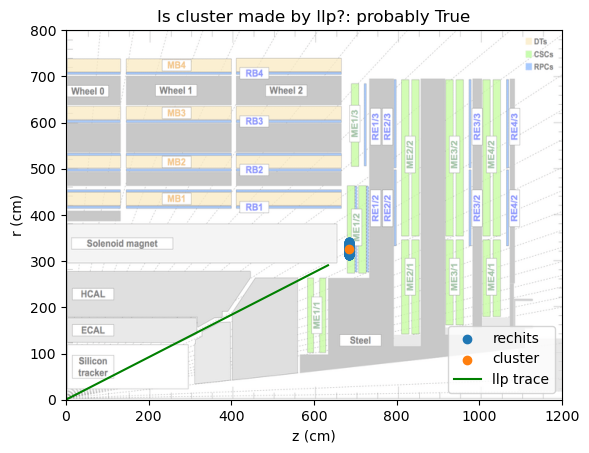

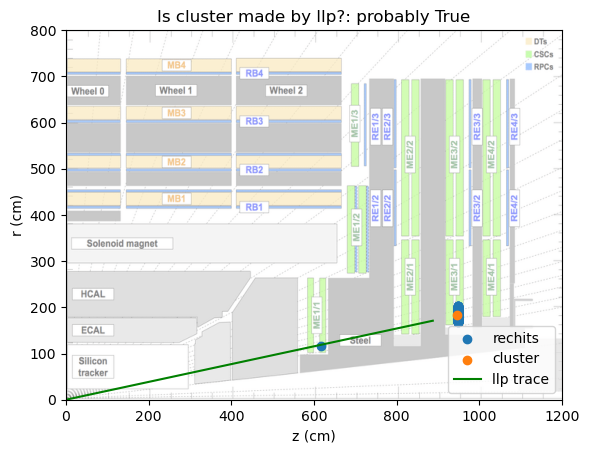

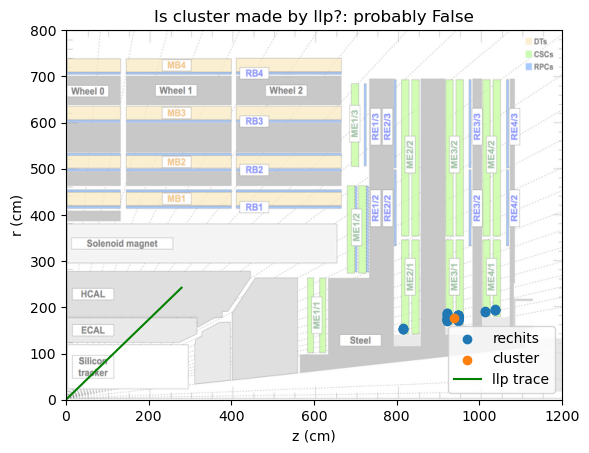

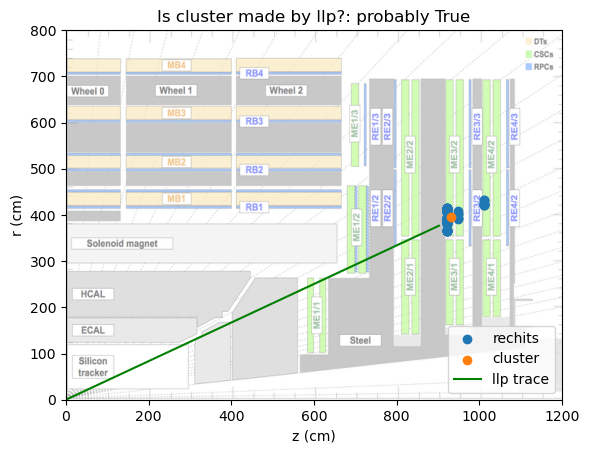

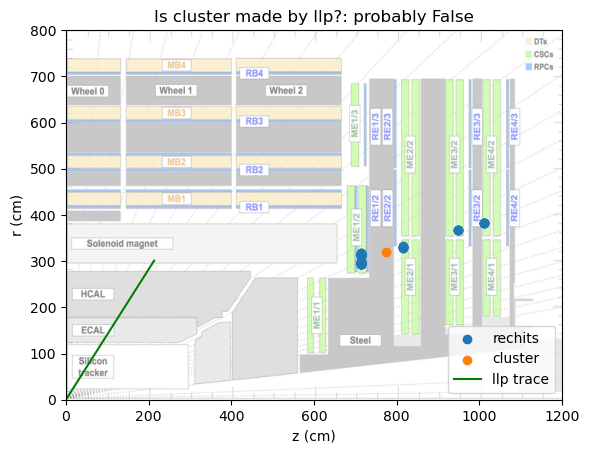

...

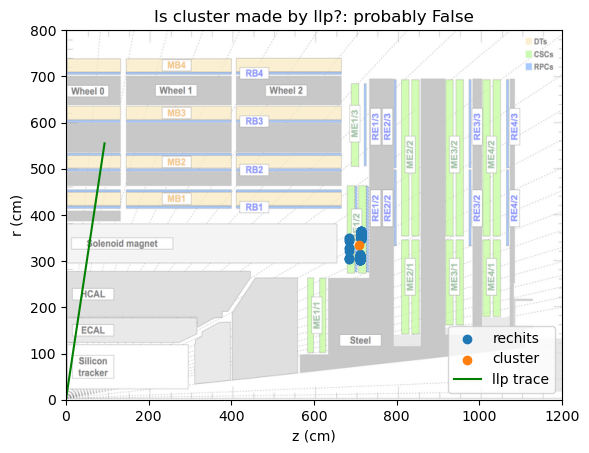

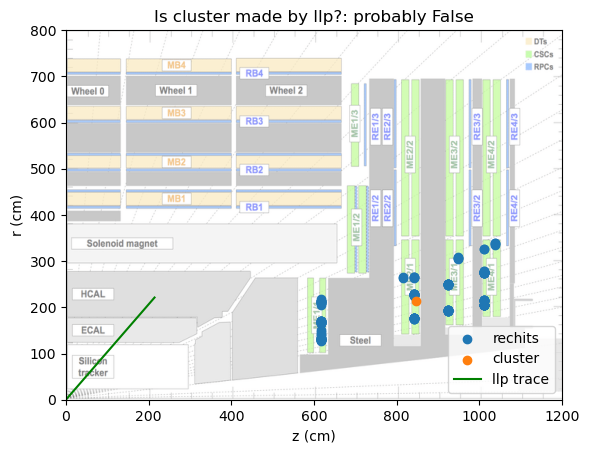

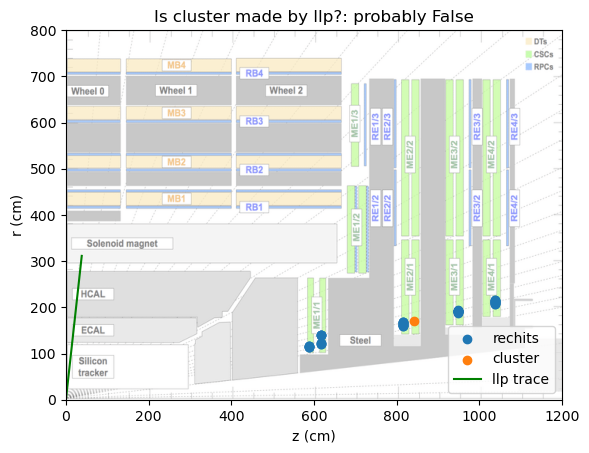

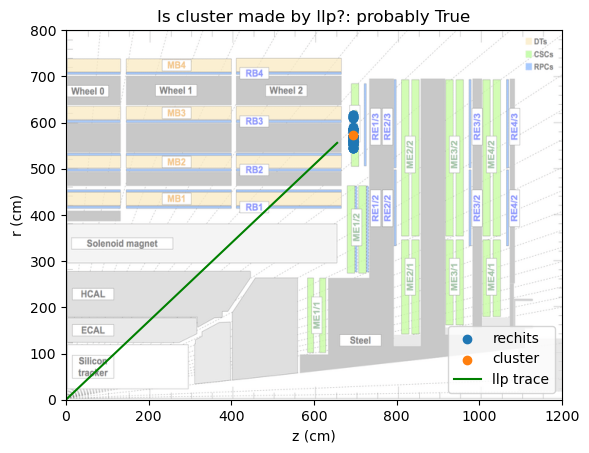

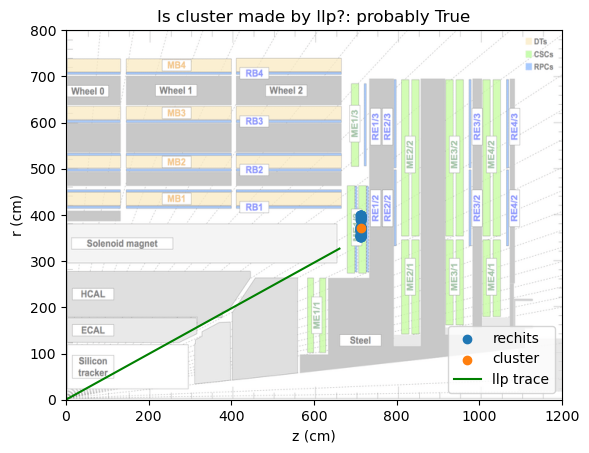

In [196]:
bg_image = mpimg.imread('cms_crosssection.png')

for rechit, cluster, llp, label in zip(cscRechits_clustered, cscClusters, gLLP, ak.flatten(labels, axis = 1)):
    rechit_r = np.sqrt(rechit.X**2 + rechit.Y**2)
    cluster_r = np.sqrt(cluster.X**2 + cluster.Y**2)

    
    plt.scatter(abs(rechit.Z), rechit_r, label = 'rechits')
    plt.scatter(abs(cluster.Z), cluster_r, label = 'cluster')
    plt.plot([0, abs(llp.decay_vertex_z)], [0, llp.decay_vertex_r], color = 'green', label = 'llp trace')  # Line from origin to the point

    plt.title(f'Is cluster made by llp?: probably {label}')
    plt.legend(loc='lower right')
    
    plt.xlim((0,1200))
    plt.ylim((0,800))
    plt.imshow(bg_image, extent=[-90, 1328, -40, 880], aspect='auto', alpha = .5)
    plt.xlabel('z (cm)')
    plt.ylabel('r (cm)')
    plt.show()
    